#### Author: Frédéric Roux, Phd
#### Donostia San Sebastian, November 2020

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#plt.style.use('seaborn-notebook')


In [2]:
import sklearn

# make sure to use the latest version of pandas and scikit-learn
if (pd.__version__ != "1.1.4") or (sklearn.__version__ != "0.23.2"):
    print("Warning: you are not using the latest modules")

###  Preprocessing

In [3]:
# set path to data-files
p2data = '/Users/froux/Documents/data/'

fnames = ['user1.txt','user2.txt','user3.txt','user4.txt']

In [4]:
# loop over file names and concatenate loaded data into dataframe
dat = pd.DataFrame()
for f,ix in zip(fnames,list(range(len(fnames)))):
    tmp = pd.read_csv(p2data+f,sep=',')
    print(f,"has",tmp.shape[0],"rows")
    tmp['user'] = ix+1
    dat = pd.concat([dat,tmp],axis=0,ignore_index=True)

user1.txt has 20266 rows
user2.txt has 60256 rows
user3.txt has 26694 rows
user4.txt has 30608 rows


In [5]:
# inspect the resulting dataframe
print(dat.shape)
print(dat.columns)
dat

(137824, 9)
Index(['timestamp', 'date_id', 'dow', 'utc_time_sec', 'offset_time_sec',
       'accuracy', 'longitude', 'latitude', 'user'],
      dtype='object')


,timestamp,date_id,dow,utc_time_sec,offset_time_sec,accuracy,longitude,latitude,user
0,2015-03-01 07:16:39,20150301,Sun,1425190599,-3600,10.000000,-64.979205,-15.687428,1
1,2015-03-01 07:17:12,20150301,Sun,1425190632,-3600,29.000000,-64.979196,-15.687460,1
2,2015-03-01 07:17:25,20150301,Sun,1425190645,-3600,33.000000,-64.979229,-15.687334,1
3,2015-03-01 07:18:19,20150301,Sun,1425190699,-3600,25.000000,-64.979197,-15.687459,1
4,2015-03-01 07:18:25,20150301,Sun,1425190705,-3600,17.677000,-64.979197,-15.687459,1
...,...,...,...,...,...,...,...,...,...
137819,2015-04-01 00:08:25,20150401,Wed,1427839705,-3600,776.625977,-64.609553,-15.031567,4
137820,2015-04-01 00:09:29,20150401,Wed,1427839769,-3600,872.018982,-64.609553,-15.031567,4
137821,2015-04-01 00:10:30,20150401,Wed,1427839830,-3600,963.453003,-64.609553,-15.031567,4
137822,2015-04-01 00:11:31,20150401,Wed,1427839891,-3600,1326.000000,-64.609553,-15.031567,4


In [6]:
# define some functions to toggle dow between str and int
def dow2num(dow):
    if dow =='Mon':
        return(1)
    if dow =='Tue':
        return(2)
    if dow =='Wed':
        return(3)
    if dow =='Thu':
        return(4)
    if dow =='Fri':
        return(5)
    if dow =='Sat':
        return(6)
    if dow =='Sun':
        return(7)
    
def num2dow(num):
    if num ==1:
        return('Mon')
    if num ==2:
        return('Tue')
    if num ==3:
        return('Wed')
    if num ==4:
        return('Thu')
    if num ==5:
        return('Fri')
    if num ==6:
        return('Sat')
    if num ==7:
        return('Sun')

In [7]:
# define function to compute distance between two points in sphere
# https://en.wikipedia.org/wiki/Haversine_formula
# https://math.stackexchange.com/questions/2978144/difference-between-haversine-and-euclidean-distance
from numpy import radians, cos, sin, arcsin, sqrt,pi

def haversine(lon, lat):
    """
    Calculate the great circle distance between two points 
    on the earth (specified in decimal degrees)
    """

    #Convert decimal degrees to Radians:
    lon = np.radians(lon)
    lat = np.radians(lat)
    
    # handle vector data
    lon1 = lon[0:len(lon)-1]
    lon2 = lon[1:len(lon)]
    lat1 = lat[0:len(lat)-1] 
    lat2 = lat[1:len(lat)]
    
    #Implementing Haversine Formula: 
    dlon = (lon2-lon1) 
    dlat = (lat2-lat1) 
    
    a = np.add(
        np.power(sin(np.divide(dlat, 2)), 2),  
            np.multiply(
                np.power(sin(np.divide(dlon, 2)), 2), 
                np.multiply(
                    cos(lat1), 
                    cos(lat2)    
                )
            )
        )
    
    c = np.multiply(2, arcsin(sqrt(a)))
    r = 6371
    
    return np.concatenate((np.zeros((1,)),c*r),axis=0)

#### Sanity check

The distance between Big Ben in London (51.5007° N, 0.1246° W) and The Statue of Liberty in
New York (40.6892° N, 74.0445° W) is **5574.8** km. 

In [8]:
tmp = pd.DataFrame([[51.5007,0.1246],[40.6892,74.0445]],columns=["latitude","longitude"])
print(tmp)
print(haversine(tmp["longitude"].values,tmp["latitude"].values)[1])

   latitude  longitude
0   51.5007     0.1246
1   40.6892    74.0445
5574.840456848555


### returns   
   latitude  longitude \
0   51.5007     0.1246 \
1   40.6892    74.0445 \
5574.840456848555

In [9]:
# convert dow from str to int
dat['downum'] = list(map(dow2num,dat['dow'].values))

#convert time-stamp values to seconds 
dat['time'] = [x.split(' ')[1] for x in dat['timestamp']]
dat['time_sec'] = [int(t.split(':')[0])*3600+int(t.split(':')[1])*60+int(t.split(':')[2]) for t in dat['time'].values]

# get unique data_id values
date_id = np.unique(dat['date_id'])

# inspect total number of unique data_ids
print(len(date_id))
#returns 32

32


In [10]:
for ix in range(len(date_id)):
    
    tmp = dat.loc[dat['date_id'] == date_id[ix],].copy()
    
    for u in np.unique(tmp['user']):
        geo_pos = tmp.loc[tmp['user']==u,['longitude','latitude','time_sec']].copy()
        
        # compute spherical distance 
        d = haversine(geo_pos.longitude.values,geo_pos.latitude.values)
        dt = (geo_pos['time_sec'].diff())
        # compute speed [km/s]
        s = (d/dt).fillna(0.)
        s[s==np.inf]=0
        s[s==-np.inf]=0
        
        geo_pos['Dist'] = d
        geo_pos['Speed'] = s
        
        tmp.loc[tmp['user']==u,'Dist'] = geo_pos['Dist']
        tmp.loc[tmp['user']==u,'Speed'] = geo_pos['Speed']
    
    dat.loc[dat['date_id'] == date_id[ix],'Dist'] = tmp['Dist']
    dat.loc[dat['date_id'] == date_id[ix],'Speed'] = tmp['Speed']
    
# sanity-check: no NaNs should be left behind    
print(any(dat['Dist'].isna()))
print(any(dat['Speed'].isna()))
print(any(dat['Dist'] == np.inf))
print(any(dat['Speed']== np.inf))

False
False
False
False


###  Exploratory analysis

Text(0, 0.5, 'Distance [km/s]')

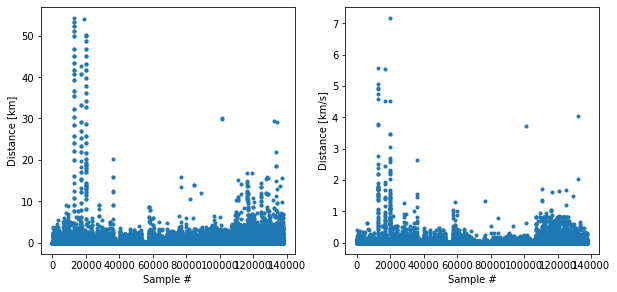

In [11]:
plt.figure(figsize=(10,10))
plt.subplot(221)
plt.plot(dat['Dist'],'.')
plt.xlabel('Sample #')
plt.ylabel('Distance [km]')
plt.subplot(222)
plt.plot(dat['Speed'],'.')
plt.xlabel('Sample #')
plt.ylabel('Distance [km/s]')


In [12]:
# split df by user and date_id
dfs = dat.groupby(['user','date_id'])
dfs = [dfs.get_group(x) for x in dfs.groups]

print("There are n= "+str(len(dfs))+" measurements (user x date_id)")

# compute some stats
df_tmp = pd.DataFrame(columns=['date_id','total_time','user','dow'])
usr = []
for i in range(len(dfs)):
    # extract unique date identifier
    df_tmp.loc[i,'date_id'] = int(np.unique(dfs[i]['date_id'].values.flatten()))
    # extract unique user identifier
    df_tmp.loc[i,'user'] = int(np.unique(dfs[i]['user'].values.flatten()))
    # extract unique dow identifier
    df_tmp.loc[i,'dow'] = np.unique(dfs[i]['dow'].values)[0]
    
    # compute total time in hrs of sample range per user and date_id
    t = dfs[i]['utc_time_sec'].values.astype(int)
    df_tmp.loc[i,'total_time'] = (max(t)-min(t))/60/60
    # compute total number of samples collected per user and date_id
    df_tmp.loc[i,'n_samples'] = int(len(dfs[i]['utc_time_sec'].values))
   

# inspect df
df_tmp    

There are n= 121 measurements (user x date_id)


,date_id,total_time,user,dow,n_samples
0,20150301,7.84167,1,Sun,885.0
1,20150302,15.85,1,Mon,1363.0
2,20150303,10.7092,1,Tue,1019.0
3,20150304,15.7194,1,Wed,1049.0
4,20150305,13.8414,1,Thu,1084.0
...,...,...,...,...,...
116,20150328,22.4331,4,Sat,712.0
117,20150329,15.2294,4,Sun,759.0
118,20150330,14.8533,4,Mon,715.0
119,20150331,16.1544,4,Tue,735.0


In [13]:
# compute total distance traveled by user at specific dow
total_d={}

# split dat by user
dfs2 = dat.groupby('user')
dfs2 = [dfs2.get_group(x) for x in dfs2.groups]
#should return 4
print(len(dfs2))

# loop over user
for ix in range(len(dfs2)):
    #get unique user identifier
    usr = int(np.unique(dfs2[ix]['user'].values))
    
    # further split df by dow
    tmp = dfs2[ix].groupby('dow')
    tmp = [tmp.get_group(x) for x in tmp.groups]
    #should return 7
    print(len(tmp))
    
    # loop over dow
    for ix2 in range(len(tmp)):
        # get unique dow identifier
        dow = str(np.unique(tmp[ix2]['dow'].values)[0])
        
        # extract geoposition for specific user 
        x = tmp[ix2]['longitude'].values
        y = tmp[ix2]['latitude'].values
        # compute spherical distance
        d = haversine(x,y)
        # compute L2-norm
        #d = np.linalg.norm([x,y],axis=0) #
        if (list(total_d.keys()).count(dow)==0):
            total_d[dow] = []
        # total distance traveled by user at dow   
        total_d[dow].append([usr,sum(d)])

# inspect dict
total_d

4
7
7
7
7


{'Fri': [[1, 142.46806053310553],
  [2, 234.46505202247823],
  [3, 381.2464154792379],
  [4, 1363.612592786522]],
 'Mon': [[1, 619.0559660412223],
  [2, 435.6762111105262],
  [3, 534.9857393748978],
  [4, 1081.6035055384127]],
 'Sat': [[1, 262.2948897743413],
  [2, 627.6330255315878],
  [3, 549.4025914713986],
  [4, 1232.488149360879]],
 'Sun': [[1, 370.9955286482481],
  [2, 458.03248568397584],
  [3, 267.80836972373714],
  [4, 2409.6560736057945]],
 'Thu': [[1, 213.84787112477107],
  [2, 255.48625426212675],
  [3, 478.5380662543046],
  [4, 1311.1406325530252]],
 'Tue': [[1, 2120.938203844221],
  [2, 394.35993002070785],
  [3, 390.4372556516837],
  [4, 1582.0491426834058]],
 'Wed': [[1, 2802.9792762001744],
  [2, 436.6047532923059],
  [3, 486.5344551987476],
  [4, 1008.0197288661864]]}

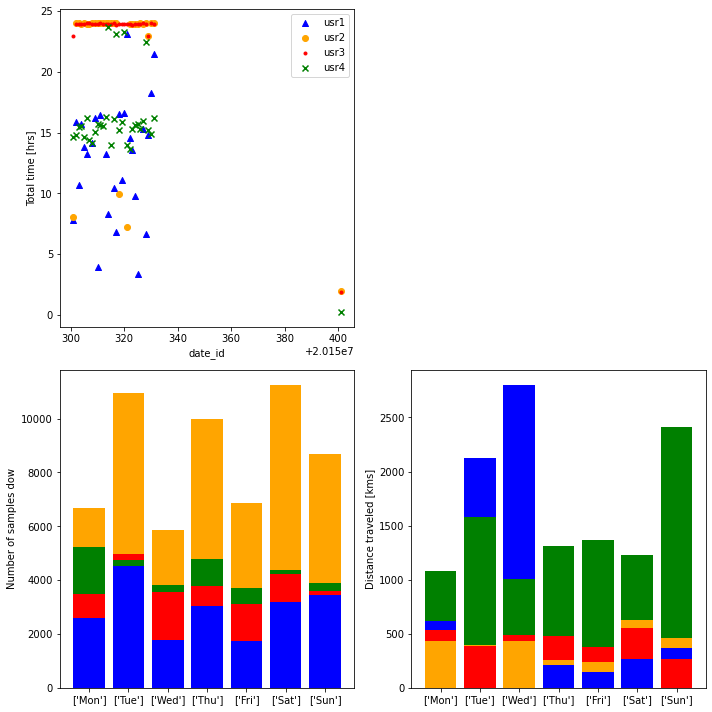

In [14]:
# make plots to visualize stats computed above

c = ['blue','orange','red','green']
m = ['^','o','.','x']

fig = plt.figure(figsize=(10,10))

ax1 = plt.subplot(2,2,1)
for i in range(1,5):
    ax1.scatter(df_tmp['date_id'].values[df_tmp['user']==i],df_tmp['total_time'].values[df_tmp['user']==i],color=c[i-1],marker=m[i-1])
ax1.legend(['usr1','usr2','usr3','usr4'])
ax1.set_xlabel('date_id')
ax1.set_ylabel('Total time [hrs]')

#ax2 = plt.subplot(2,2,2)

ax3 = plt.subplot(2,2,3)
g = df_tmp.groupby('dow')
g = [g.get_group(x) for x in g.groups]
dow=[]
for i in range(len(g)):
    dow.append(np.unique(g[i]['dow'].values))
    v = [g[i]['n_samples'].values[g[i]['user']==j].sum() for j in range(1,5)]
    x = np.argsort(v)[::-1]
    for j in range(len(x)):
        plt.bar(i+1,v[x[j]],color=c[x[j]])

s_ix = np.argsort(list(map(dow2num,dow))).flatten()
ax3.set_xticks(list(range(1,8)))
ax3.set_xticklabels([dow[ix] for ix in s_ix])
ax3.set_ylabel('Number of samples dow')

ax4 = plt.subplot(2,2,4)
for k in total_d.keys():
    x = dow2num(k)
    v = total_d[k]
    d = np.asarray(v)[:,1]
    u = np.argsort(d)[::-1]
    
    for i in range(len(u)):
        plt.bar(x,d[u[i]],color=c[u[i]])
ax4.set_xticks(list(range(1,8)))
ax4.set_xticklabels([dow[ix] for ix in s_ix])
ax4.set_ylabel('Distance traveled [kms]')

plt.tight_layout()

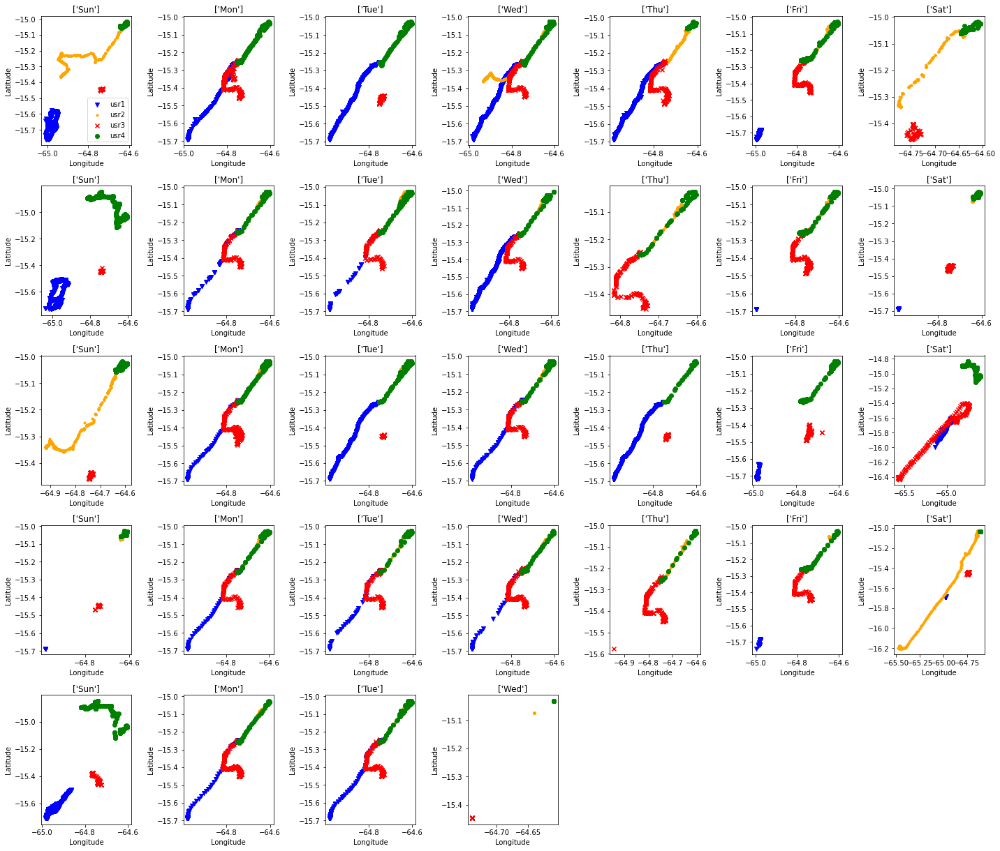

In [15]:
# make plots to visualize trajectories of users for differente date-ids

fig = plt.figure(figsize=(20,20))
for ix in range(len(date_id)):
    tmp = dat.loc[dat['date_id'] == date_id[ix],]
    long = tmp['longitude'].values
    lat = tmp['latitude'].values
    ax = plt.subplot(6,7,ix+1)
    ax.scatter(long[tmp['user']==1],lat[tmp['user']==1],color='blue',marker='v')
    ax.scatter(long[tmp['user']==2],lat[tmp['user']==2],color='orange',marker='.')
    ax.scatter(long[tmp['user']==3],lat[tmp['user']==3],color='red',marker='x')
    ax.scatter(long[tmp['user']==4],lat[tmp['user']==4],color='green',marker='o')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    plt.title(np.unique(tmp['dow']))
    if (ix==0):
        plt.legend(['usr1','usr2','usr3','usr4'])
plt.tight_layout()

(2438, 14)


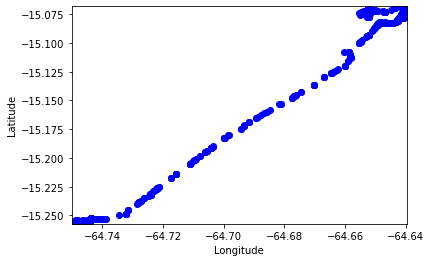

In [16]:
# make animation to visualize dynamic trajectory of user for specific date

import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

from matplotlib import pyplot as plt
from celluloid import Camera

tmp = dat.loc[dat['user']==2,]
tmp = tmp.loc[tmp['date_id']==date_id[4],]
tmp = tmp.loc[tmp['accuracy']<500,]
print(tmp.shape)

long = tmp['longitude'].values
lat = tmp['latitude'].values
t = tmp['utc_time_sec'].values

# create figure object
fig = plt.figure()
# load axis box,set axis limit
ax = plt.axes(xlim=(np.min(long),np.max(long)),ylim=(np.min(lat),np.max(lat)))
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

camera = Camera(fig)
for i in range(len(long)):
    ax.scatter(long[:i], lat[:i],color='blue')
    camera.snap()
    
animation = camera.animate()
#animation.save('animation.gif', writer='PillowWriter', fps=2)

from IPython.display import HTML
HTML(animation.to_jshtml())

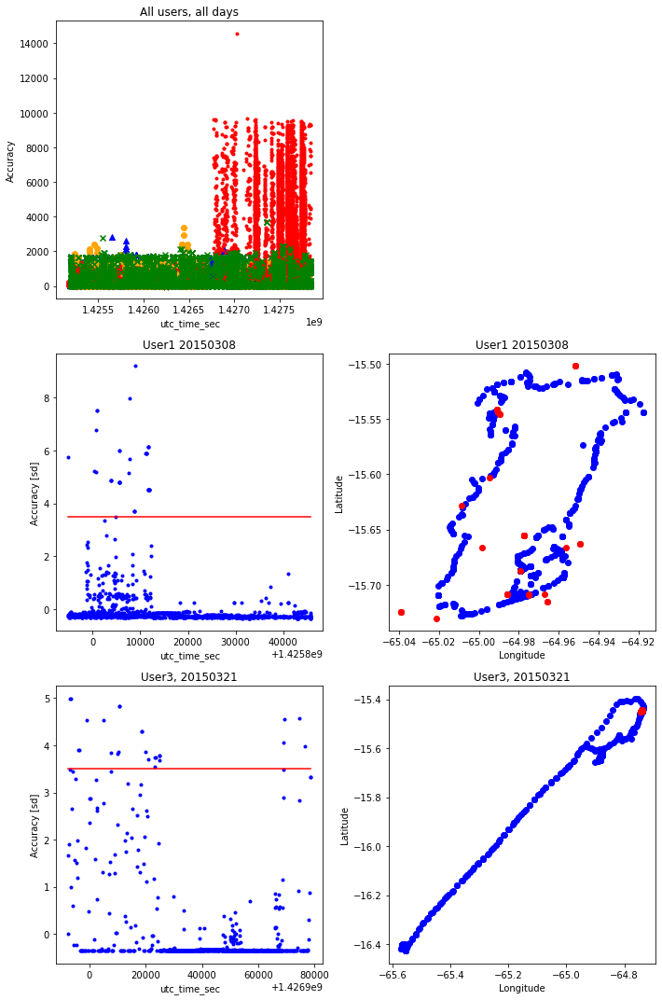

In [17]:
# make plot to visualize distribution of sensor-based noise

from sklearn.preprocessing import scale

fig = plt.figure(figsize=(10,15))

ax = plt.subplot(3,2,1)
for u in range(1,5):
    ax.scatter(dat['utc_time_sec'].values[dat['user']==u],dat['accuracy'].values[dat['user']==u],color=c[u-1],marker=m[u-1])
ax.set_xlabel('utc_time_sec')
ax.set_ylabel('Accuracy')
ax.set_title('All users, all days')

#user 1
tmp = dat.loc[dat['user']==1,]
tmp = tmp.loc[tmp['date_id']==date_id[7],]
long = tmp['longitude'].values
lat = tmp['latitude'].values
t = tmp['utc_time_sec'].values

ax = plt.subplot(3,2,3)
ac_sacled = scale(tmp['accuracy'])
plt.scatter(tmp['utc_time_sec'],ac_sacled,marker='.',color='blue')
plt.plot([np.min(tmp['utc_time_sec'].values),np.max(tmp['utc_time_sec'].values)],[3.5,3.5],color='red')
ax.set_xlabel('utc_time_sec')
ax.set_ylabel('Accuracy [sd]')
ax.set_title('User1 '+str(date_id[7]))

ax = plt.subplot(3,2,4)
plt.scatter(long[ac_sacled<=3.5],lat[ac_sacled<=3.5],color='blue')
plt.scatter(long[ac_sacled>3.5],lat[ac_sacled>3.5],color='red')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('User1 '+str(date_id[7]))

#user 3
tmp = dat.loc[dat['user']==3,]
tmp = tmp.loc[tmp['date_id']==date_id[20],]
long = tmp['longitude'].values
lat = tmp['latitude'].values
t = tmp['utc_time_sec'].values

ax = plt.subplot(3,2,5)
ac_sacled = scale(tmp['accuracy'])
plt.scatter(tmp['utc_time_sec'],ac_sacled,marker='.',color='blue')
plt.plot([np.min(tmp['utc_time_sec'].values),np.max(tmp['utc_time_sec'].values)],[3.5,3.5],color='red')
ax.set_xlabel('utc_time_sec')
ax.set_ylabel('Accuracy [sd]')
ax.set_title('User3, '+str(date_id[20]))

ax = plt.subplot(3,2,6)
plt.scatter(long[ac_sacled<=3.5],lat[ac_sacled<=3.5],color='blue')
plt.scatter(long[ac_sacled>3.5],lat[ac_sacled>3.5],color='red')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('User3, '+str(date_id[20]))

plt.tight_layout()

In [18]:
# maybe quantiles would be better suited
tmp = dat.loc[dat['user']==3,]
tmp = tmp.loc[tmp['date_id']==date_id[20],]

np.quantile(tmp['accuracy'],[.25,.75])

array([20.        , 52.23824882])

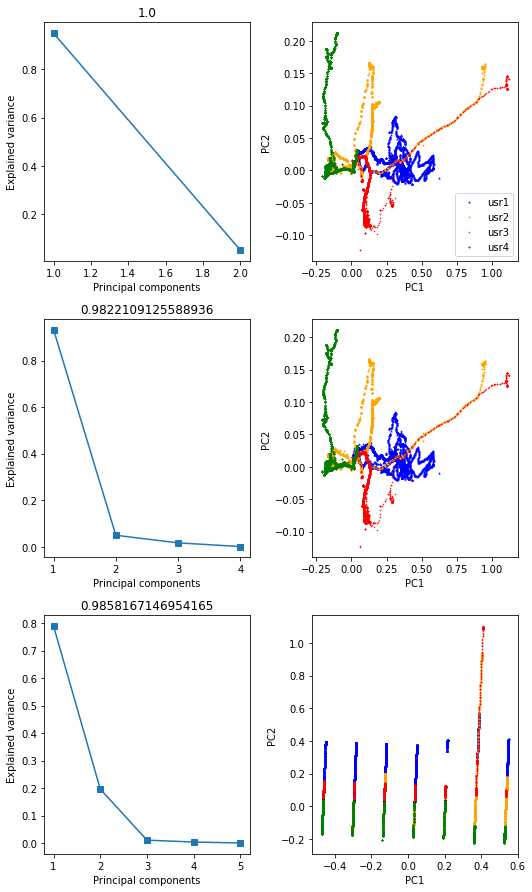

In [19]:
# make plots to inspect if PCs can separate user-trajectory

from sklearn.decomposition import PCA
from sklearn.preprocessing import minmax_scale

fig = plt.figure(figsize=(7.5,12.5))

X = dat.loc[:,['longitude','latitude']] 
X = minmax_scale(X)
pca = PCA(n_components=X.shape[1])
data_pcs = pca.fit_transform(X)

ax = plt.subplot(3,2,1)
plt.plot(np.arange(X.shape[1])+1,pca.explained_variance_ratio_,marker='s')
ax.set_xlabel('Principal components')
ax.set_ylabel('Explained variance')
ax.set_title(str(sum(pca.explained_variance_ratio_[0:2])))

ax = plt.subplot(3,2,2)
for j in range(1,5):
    sel_ix = np.where(dat.loc[:,'user']==j)[0]
    ax.scatter(data_pcs[sel_ix,0], data_pcs[sel_ix,1], s=1,color=c[j-1],marker=m[j-1])
ax.set_xlabel('PC'+str(1))
ax.set_ylabel('PC'+str(2))
ax.legend(['usr1','usr2','usr3','usr4'])

X = dat.loc[:,['longitude','latitude','Dist','Speed']]
X = minmax_scale(X)
pca = PCA(n_components=X.shape[1])
data_pcs = pca.fit_transform(X)

ax = plt.subplot(3,2,3)
plt.plot(np.arange(X.shape[1])+1,pca.explained_variance_ratio_,marker='s')
ax.set_xlabel('Principal components')
ax.set_ylabel('Explained variance')
ax.set_title(str(sum(pca.explained_variance_ratio_[0:2])))

ax = plt.subplot(3,2,4)
for j in range(1,5):
    sel_ix = np.where(dat.loc[:,'user']==j)[0]
    ax.scatter(data_pcs[sel_ix,0], data_pcs[sel_ix,1], s=1,color=c[j-1],marker=m[j-1])
ax.set_xlabel('PC'+str(1))
ax.set_ylabel('PC'+str(2))


X = dat.loc[:,['longitude','latitude','Speed','Dist','downum']]
X = minmax_scale(X)
pca = PCA(n_components=X.shape[1])
data_pcs = pca.fit_transform(X)

ax = plt.subplot(3,2,5)
plt.plot(np.arange(X.shape[1])+1,pca.explained_variance_ratio_,marker='s')
ax.set_xlabel('Principal components')
ax.set_ylabel('Explained variance')
ax.set_title(str(sum(pca.explained_variance_ratio_[0:2])))

ax = plt.subplot(3,2,6)
for j in range(1,5):
    sel_ix = np.where(dat.loc[:,'user']==j)[0]
    ax.scatter(data_pcs[sel_ix,0], data_pcs[sel_ix,1], s=1,color=c[j-1],marker=m[j-1])
ax.set_xlabel('PC'+str(1))
ax.set_ylabel('PC'+str(2))


plt.tight_layout()

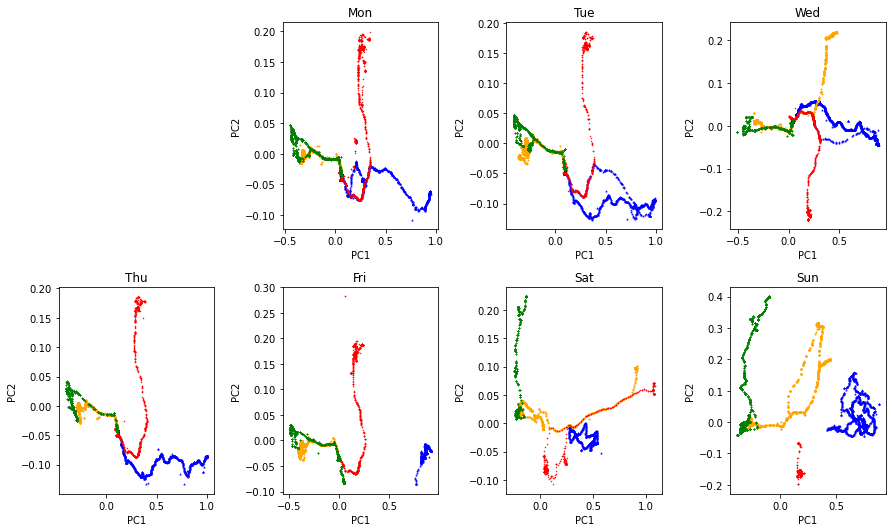

In [20]:
# make plots to inspect if PCs can separate user-trajectory by holding dow constant

fig = plt.figure(figsize=(12.5,7.5))

for i in range(1,8):
    
    tmp = dat.loc[dat['downum'].values==i,['longitude','latitude','user','Dist','Speed','downum']]
    X = minmax_scale(tmp[['longitude','latitude']]) #.loc[:,['longitude','latitude']]
    pca = PCA(n_components=X.shape[1])
    data_pcs = pca.fit_transform(X)

    ax = plt.subplot(2,4,i+1)
    for j in range(1,5):
        sel_ix = np.where(tmp['user'].values==j)[0]
        ax.scatter(data_pcs[sel_ix,0], data_pcs[sel_ix,1], s=1,color=c[j-1],marker=m[j-1])

    ax.set_title(num2dow(i))
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    
    plt.tight_layout()

### Predictive analysis: Predict user identity

In [21]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split

# build feature matrix (x) and class vector (y)
X = dat.loc[:,['date_id','time_sec','user','longitude','latitude','downum','Dist','Speed']]
y = dat.loc[:,['date_id','time_sec','user']]

In [22]:
X.sort_values(by=['date_id','time_sec','user'])
X

,date_id,time_sec,user,longitude,latitude,downum,Dist,Speed
0,20150301,26199,1,-64.979205,-15.687428,7,0.000000,0.000000
1,20150301,26232,1,-64.979196,-15.687460,7,0.003643,0.000110
2,20150301,26245,1,-64.979229,-15.687334,7,0.014390,0.001107
3,20150301,26299,1,-64.979197,-15.687459,7,0.014349,0.000266
4,20150301,26305,1,-64.979197,-15.687459,7,0.000000,0.000000
...,...,...,...,...,...,...,...,...
137819,20150401,505,4,-64.609553,-15.031567,3,0.000000,0.000000
137820,20150401,569,4,-64.609553,-15.031567,3,0.000000,0.000000
137821,20150401,630,4,-64.609553,-15.031567,3,0.000000,0.000000
137822,20150401,691,4,-64.609553,-15.031567,3,0.000000,0.000000


In [23]:
y.sort_values(by=['date_id','time_sec','user'])
y

,date_id,time_sec,user
0,20150301,26199,1
1,20150301,26232,1
2,20150301,26245,1
3,20150301,26299,1
4,20150301,26305,1
...,...,...,...
137819,20150401,505,4
137820,20150401,569,4
137821,20150401,630,4
137822,20150401,691,4


In [24]:
X.drop('user', axis=1, inplace=True)

y.drop('date_id', axis=1, inplace=True)
y.drop('time_sec', axis=1, inplace=True)

In [25]:
# split data into train and test subsets preserve temporal structure
print(len(date_id))

X_train = X.loc[X['date_id']<date_id[22],]
y_train = y.loc[X['date_id']<date_id[22],]

X_test = X.loc[X['date_id']>=date_id[22],]
y_test = y.loc[X['date_id']>=date_id[22],]

print(X_train.shape)
print(X_test.shape)

print(X_test.shape[0]/X_train.shape[0])

32
(105205, 7)
(32619, 7)
0.31005180362150087


In [26]:
# Add PCs to the feature matrix
X_train_sc = X_train.copy()
scaler = MinMaxScaler()
scaler.fit(X_train_sc)
X_train_sc = scaler.transform(X_train_sc)
pca = PCA(n_components=X_train_sc.shape[1])
data_pcs = pca.fit_transform(X_train_sc)

for ix in range(data_pcs.shape[1]):
    k = 'data_pc'+str(ix)
    X_train[k] = data_pcs[:,ix]
    
X_test_sc = X_test.copy()
X_test_sc = scaler.transform(X_test_sc)
X_test_f = pca.transform(X_test_sc)
for ix in range(X_test_f.shape[1]):
    k = 'data_pc'+str(ix)
    X_test[k] = X_test_f[:,0]

print(X_train.shape)
print(X_test.shape)

(105205, 14)
(32619, 14)


<ipython-input-26-911e28bbb4b8>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train[k] = data_pcs[:,ix]
<ipython-input-26-911e28bbb4b8>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test[k] = X_test_f[:,0]


In [27]:
# Feature scaling: StandardScaler
scaler = StandardScaler().fit(X_train)
scaler.fit(X_train)
X_train_sc = scaler.transform(X_train)
X_test_sc = scaler.transform(X_test)

print(np.min(X_train_sc),np.max(X_train_sc)) 
print(np.min(X_test_sc),np.max(X_test_sc))

#returns 
#-7.086759180987705 45.027806830165694
#-7.086759854423157 43.43983503624828

-37.87141904104782 84.28422217400569
-53.69013410529311 193.52854899185957


In [28]:
# Feature scaling: minmax_scaler
scaler = MinMaxScaler()
scaler.fit(X_train)

X_train_sc = scaler.transform(X_train)
X_test_sc = scaler.transform(X_test)

print(np.min(X_train_sc),np.max(X_train_sc)) 
print(np.min(X_test_sc),np.max(X_test_sc))

#returns 
#0.0 1.0
#0.0 1.0

0.0 1.0000000000000002
-0.6654763133374972 4.761904761893675


In [29]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

X_train = np.asarray(X_train)
y_train = np.asarray(y_train).flatten()
X_test = np.asarray(X_test)
y_test = np.asarray(y_test).flatten()

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(105205, 14)
(105205, 1)
(32619, 14)
(32619, 1)
(105205, 14)
(105205,)
(32619, 14)
(32619,)


In [30]:
from sklearn.model_selection import GroupShuffleSplit

gss = GroupShuffleSplit(n_splits=5,test_size=0.2, random_state=0)
gss.get_n_splits()
groups = X['date_id'][X['date_id']<date_id[22]]
gss.split(X_train, y_train, groups)
gss

GroupShuffleSplit(n_splits=5, random_state=0, test_size=0.2, train_size=None)

In [31]:
for train_idx, test_idx in gss.split(X_train, y_train, groups):
    print("TRAIN:", np.unique(y_train[train_idx]), "TEST:", np.unique(y_train[test_idx]))

TRAIN: [1 2 3 4] TEST: [1 2 3 4]
TRAIN: [1 2 3 4] TEST: [1 2 3 4]
TRAIN: [1 2 3 4] TEST: [1 2 3 4]
TRAIN: [1 2 3 4] TEST: [1 2 3 4]
TRAIN: [1 2 3 4] TEST: [1 2 3 4]


[20150301 20150301 20150301 ... 20150322 20150322 20150322]


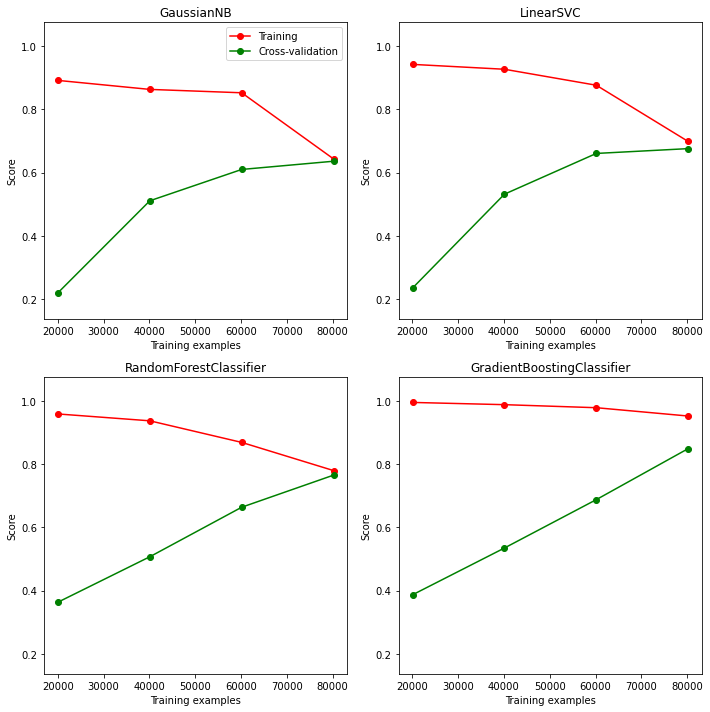

In [32]:
# compare simple model performances (no parameter tuning)

from sklearn.naive_bayes import GaussianNB
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import learning_curve, GroupShuffleSplit

estimator = []
estimator.append(GaussianNB()) # naive bayes
estimator.append(LinearSVC(multi_class="ovr", max_iter=1e3, dual=False, random_state=0)) # linear SVM
estimator.append(RandomForestClassifier(max_depth=2, random_state=0)) # random forest
estimator.append(GradientBoostingClassifier(criterion='friedman_mse',random_state=0)) # gradient boosting

# create cv partition that retain time structure
gss = GroupShuffleSplit(n_splits=5,test_size=0.2, random_state=0)
gss.get_n_splits()
groups = X['date_id'][X['date_id']<date_id[22]].values
print(groups)
gss.split(X_train, y_train, groups)

# make figure of learning curve
fig = plt.figure(figsize=(10,10))
ax = []
for ix,e in zip(range(0,len(estimator)),estimator):
    # compute learning curve
    train_sizes, train_scores, test_scores = learning_curve(
                    e, 
                    X_train_sc, 
                    y_train, 
                    train_sizes=np.linspace(.25, 1.0, 4),
                    cv=gss, 
                    groups=groups,
                    n_jobs=1,
                    return_times=False
                )

    ax.append(plt.subplot(2,2,ix+1))
    ax[ix].plot(train_sizes, np.mean(train_scores,axis=1), 'o-', color="r",label="Training score")
    ax[ix].plot(train_sizes, np.mean(test_scores,axis=1), 'o-', color="g",label="Cross-validation score")
    ax[ix].set_xlabel("Training examples")
    ax[ix].set_ylabel("Score")

# adjust the y-axis and add title
m = []
for a in ax:
    m.append( np.asarray(a.get_ylim()) )
yl = [np.min(np.asarray(m))-.05,np.max(np.asarray(m))+.05]
for ix,a in zip(range(len(ax)),ax):
    a.set_ylim(yl)
    a.set_title(str(estimator[ix]).split('(')[0])

ax[0].legend(['Training','Cross-validation'])    
plt.tight_layout()

In [33]:
# split data into train and test subsets preserve temporal structure
print(len(date_id))

X_train = X.loc[X['date_id']<date_id[22],]
y_train = y.loc[X['date_id']<date_id[22],]

X_test = X.loc[X['date_id']>=date_id[22],]
y_test = y.loc[X['date_id']>=date_id[22],]

print(X_train.shape)
print(X_test.shape)

print(X_test.shape[0]/X_train.shape[0])

32
(105205, 7)
(32619, 7)
0.31005180362150087


In [34]:
# Add PCs to the feature matrix
X_train_sc = X_train.copy()
scaler = MinMaxScaler()
scaler.fit(X_train_sc)
X_train_sc = scaler.transform(X_train_sc)
pca = PCA(n_components=X_train_sc.shape[1])
data_pcs = pca.fit_transform(X_train_sc)

for ix in range(data_pcs.shape[1]):
    k = 'data_pc'+str(ix)
    X_train[k] = data_pcs[:,ix]
    
X_test_sc = X_test.copy()
X_test_sc = scaler.transform(X_test_sc)
X_test_f = pca.transform(X_test_sc)
for ix in range(X_test_f.shape[1]):
    k = 'data_pc'+str(ix)
    X_test[k] = X_test_f[:,0]

print(X_train.shape)
print(X_test.shape)

(105205, 14)
(32619, 14)


<ipython-input-34-911e28bbb4b8>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train[k] = data_pcs[:,ix]
<ipython-input-34-911e28bbb4b8>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test[k] = X_test_f[:,0]


In [35]:
X_train = np.asarray(X_train)
y_train = np.asarray(y_train).flatten()

X_test = np.asarray(X_test)
y_test = np.asarray(y_test).flatten()

In [36]:
# parameter tuning on random forest 

from sklearn.pipeline import Pipeline
from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import GridSearchCV
from sklearn.feature_selection import mutual_info_classif, SelectKBest, SelectFpr, chi2, f_classif
from sklearn.ensemble import ExtraTreesClassifier

calibrated_forest = CalibratedClassifierCV(
    base_estimator=RandomForestClassifier()
)

pipe1 = Pipeline([
    ('scaler', MinMaxScaler()),
    ('select', SelectFpr()),
    ('model', calibrated_forest)
])

pipe2 = Pipeline([
    ('scaler', MinMaxScaler()),
    ('select', SelectKBest()),
    ('model', calibrated_forest)
])

param_grid1 = {
    'select__score_func':[chi2,f_classif],
    'model__base_estimator__max_depth': [2, 4, 8],    # Maximum depth of the tree 8,10
    'model__base_estimator__n_estimators': [5,10,20], # Number of trees in the forest 15
    'model__base_estimator__random_state': [0]        # Controls randomness of bootstrapping of the samples
}

param_grid2 = {
    'select__k': list(range(1,X_train.shape[1]+1)),   #Number of top features to select. list(range(X_train.shape[1]))
    'select__score_func':[chi2,f_classif],
    'model__base_estimator__max_depth': [2, 4, 8],    # Maximum depth of the tree 8,10
    'model__base_estimator__n_estimators': [5,10,20], # Number of trees in the forest 15
    'model__base_estimator__random_state': [0]        # Controls randomness of bootstrapping of the samples
}

In [37]:
search1 = GridSearchCV(pipe1, param_grid1, cv=gss).fit(X_train, y_train, groups=groups)
search2 = GridSearchCV(pipe2, param_grid2, cv=gss).fit(X_train, y_train, groups=groups)

print(np.max(search1.cv_results_['mean_test_score']))
print(np.max(search2.cv_results_['mean_test_score']))

# returns
# 0.8480137855976784
# 0.8434971884636313

0.8612423888888092
0.8749690468603244


In [38]:
search1.get_params

<bound method BaseEstimator.get_params of GridSearchCV(cv=GroupShuffleSplit(n_splits=5, random_state=0, test_size=0.2, train_size=None),
             estimator=Pipeline(steps=[('scaler', MinMaxScaler()),
                                       ('select', SelectFpr()),
                                       ('model',
                                        CalibratedClassifierCV(base_estimator=RandomForestClassifier()))]),
             param_grid={'model__base_estimator__max_depth': [2, 4, 8],
                         'model__base_estimator__n_estimators': [5, 10, 20],
                         'model__base_estimator__random_state': [0],
                         'select__score_func': [<function chi2 at 0x7fe15eec6e50>,
                                                <function f_classif at 0x7fe15eec6af0>]})>

In [39]:
search2.get_params

<bound method BaseEstimator.get_params of GridSearchCV(cv=GroupShuffleSplit(n_splits=5, random_state=0, test_size=0.2, train_size=None),
             estimator=Pipeline(steps=[('scaler', MinMaxScaler()),
                                       ('select', SelectKBest()),
                                       ('model',
                                        CalibratedClassifierCV(base_estimator=RandomForestClassifier()))]),
             param_grid={'model__base_estimator__max_depth': [2, 4, 8],
                         'model__base_estimator__n_estimators': [5, 10, 20],
                         'model__base_estimator__random_state': [0],
                         'select__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                       13, 14],
                         'select__score_func': [<function chi2 at 0x7fe15eec6e50>,
                                                <function f_classif at 0x7fe15eec6af0>]})>

In [41]:
# parameter tuning on gradient boosting classifier

calibrated_gradient = CalibratedClassifierCV(
    base_estimator=GradientBoostingClassifier()
)

pipe3 = Pipeline([
    ('scaler', MinMaxScaler()),
    ('select', SelectKBest()),
    ('model', calibrated_gradient)
])

param_grid3 = {
    'select__k': list(range(1,X_train.shape[1]+1)),   #Number of top features to select. 
    #'model__base_estimator__criterion': ['friedman_mse', 'mse'],
    'model__base_estimator__max_depth': [3, 9],    # Maximum depth of individual regression estimators
    'model__base_estimator__n_estimators': [100,150], # Number of estimators
    'model__base_estimator__random_state': [0]        # Controls randomness of bootstrapping of the samples
}

search3 = GridSearchCV(pipe3, param_grid3, cv=gss).fit(X_train, y_train,groups=groups)

print(np.max(search3.cv_results_['mean_test_score']))

0.8827818797758559


In [44]:
search1.cv_results_['params']

[{'model__base_estimator__max_depth': 2,
  'model__base_estimator__n_estimators': 5,
  'model__base_estimator__random_state': 0,
  'select__score_func': <function sklearn.feature_selection._univariate_selection.chi2(X, y)>},
 {'model__base_estimator__max_depth': 2,
  'model__base_estimator__n_estimators': 5,
  'model__base_estimator__random_state': 0,
  'select__score_func': <function sklearn.feature_selection._univariate_selection.f_classif(X, y)>},
 {'model__base_estimator__max_depth': 2,
  'model__base_estimator__n_estimators': 10,
  'model__base_estimator__random_state': 0,
  'select__score_func': <function sklearn.feature_selection._univariate_selection.chi2(X, y)>},
 {'model__base_estimator__max_depth': 2,
  'model__base_estimator__n_estimators': 10,
  'model__base_estimator__random_state': 0,
  'select__score_func': <function sklearn.feature_selection._univariate_selection.f_classif(X, y)>},
 {'model__base_estimator__max_depth': 2,
  'model__base_estimator__n_estimators': 20,
  

In [66]:
search1.cv_results_['params'][np.where(search1.cv_results_['mean_test_score'] == np.max(search1.cv_results_['mean_test_score']))[0][0]]

{'model__base_estimator__max_depth': 8,
 'model__base_estimator__n_estimators': 10,
 'model__base_estimator__random_state': 0,
 'select__score_func': <function sklearn.feature_selection._univariate_selection.chi2(X, y)>}

(0.5, 1.0)

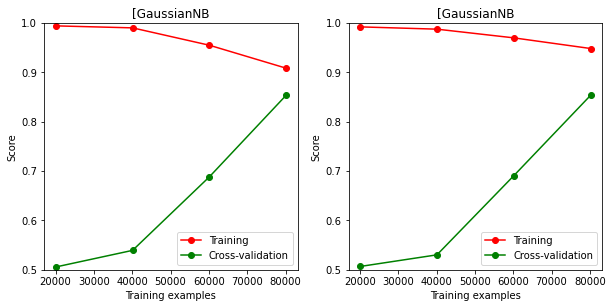

In [72]:
# visualize learning curve of optimized model

fig = plt.figure(figsize=(10,10))
ax = plt.subplot(2,2,1)

p = search2.cv_results_['params'][
    np.where( search2.cv_results_['mean_test_score'] == np.max(search2.cv_results_['mean_test_score']) )[0][0]
]

estimator1 = search2.best_estimator_[2]

scaler1 = MinMaxScaler().fit(X_train)
X_train_new = scaler1.transform(X_train)

fs1 = SelectKBest(k=p['select__k']).fit(X_train_new, y_train)
X_train_new= fs1.transform(X_train_new)

train_sizes, train_scores, test_scores = learning_curve(
    estimator1, 
    X_train_new, 
    y_train, 
    train_sizes=np.linspace(.25, 1.0, 4),
    cv=gss, 
    groups=groups,
    n_jobs=1,
    return_times=False
)

ax.plot(train_sizes, np.mean(train_scores,axis=1), 'o-', color="r",label="Training score")
ax.plot(train_sizes, np.mean(test_scores,axis=1), 'o-', color="g",label="Cross-validation score")
ax.set_xlabel("Training examples")
ax.set_ylabel("Score")
ax.legend(['Training','Cross-validation'])    
ax.set_title(str(estimator).split('(')[0])
ax.set_ylim([.5,1])

ax = plt.subplot(2,2,2)
p = search3.cv_results_['params'][
    np.where( search3.cv_results_['mean_test_score'] == np.max(search3.cv_results_['mean_test_score']) )[0][0]
]

estimator2 = search3.best_estimator_[2]

scaler2 = MinMaxScaler().fit(X_train)
X_train_new = scaler2.transform(X_train)

fs2 = SelectKBest(k=p['select__k']).fit(X_train_new, y_train)
X_train_new= fs2.transform(X_train_new)

train_sizes, train_scores, test_scores = learning_curve(
    estimator2, 
    X_train_new, 
    y_train, 
    train_sizes=np.linspace(.25, 1.0, 4),
    cv=gss, 
    groups=groups,
    n_jobs=1,
    return_times=False
)

ax.plot(train_sizes, np.mean(train_scores,axis=1), 'o-', color="r",label="Training score")
ax.plot(train_sizes, np.mean(test_scores,axis=1), 'o-', color="g",label="Cross-validation score")
ax.set_xlabel("Training examples")
ax.set_ylabel("Score")
ax.legend(['Training','Cross-validation'])    
ax.set_title(str(estimator).split('(')[0])
ax.set_ylim([.5,1])

In [70]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score


X_test_new = scaler1.transform(X_test)
X_test_new = fs1.transform(X_test_new)

y_pred = estimator1.predict(X_test_new)

cm1 = confusion_matrix(y_test, y_pred)
print(cm1)
print(accuracy_score(y_test, y_pred))


X_test_new = scaler2.transform(X_test)
X_test_new = fs2.transform(X_test_new)

y_pred = estimator2.predict(X_test_new)

cm2 = confusion_matrix(y_test, y_pred)
print(cm2)
print(accuracy_score(y_test, y_pred))

[[1280  399 2243  190]
 [ 609 6357 3325 2417]
 [1249 1605 6016  250]
 [ 392 1435 1272 3580]]
0.5283117201630951
[[ 1592  1188  1059   273]
 [   82 10052  1953   621]
 [   40  4700  3650   730]
 [    0   721  1028  4930]]
0.6200067445353935


[ ? ] **Model has high bias, ie it does not generalize well to new cases (overfitting): Redo analysis with different train-test split, ie 60-40 instead of 80-20. This should improve generability.**

[ ? ] **Remove samples whith low accuracy to improve signal**

# pca, multdim scaling -> welches space halten die sich auf, feature: velocity,mean distance zwischen den punkten

Possible features: \
* travel speed \
* distance between adjacent points

l2 norm als distanzmass: lstm model
regression, gradient boosting

wie gross ist laengste sequenz

welcher user ist das?